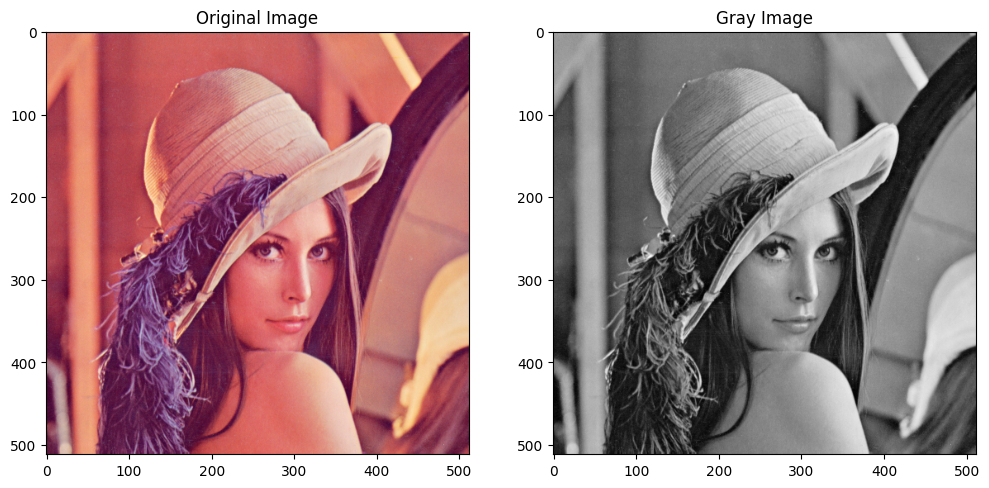

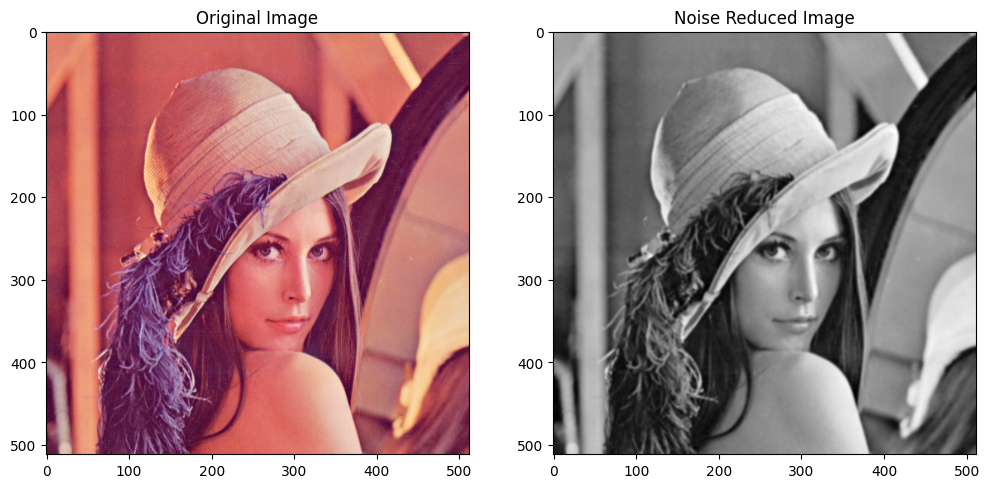

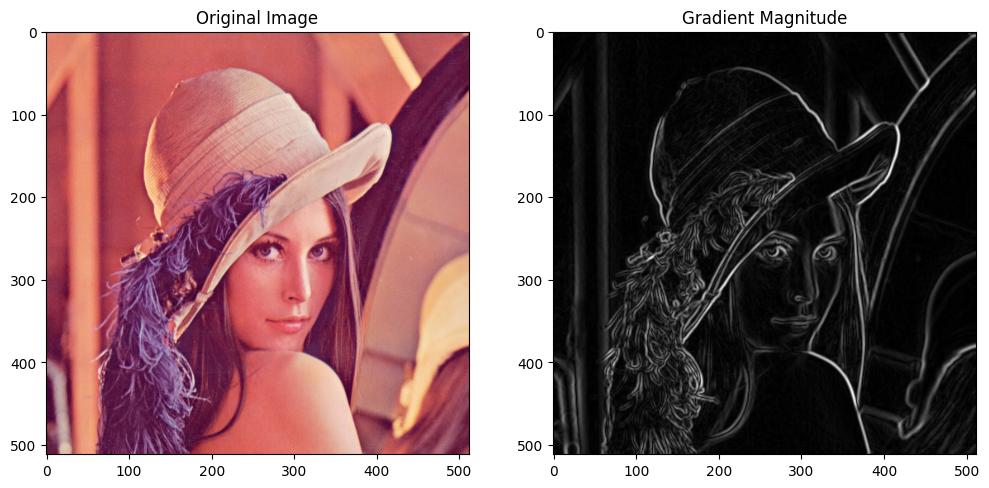

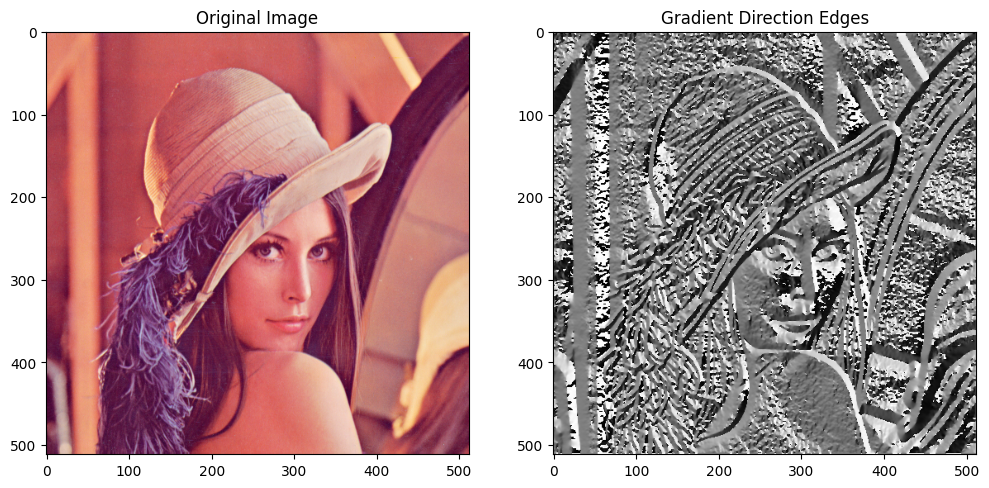

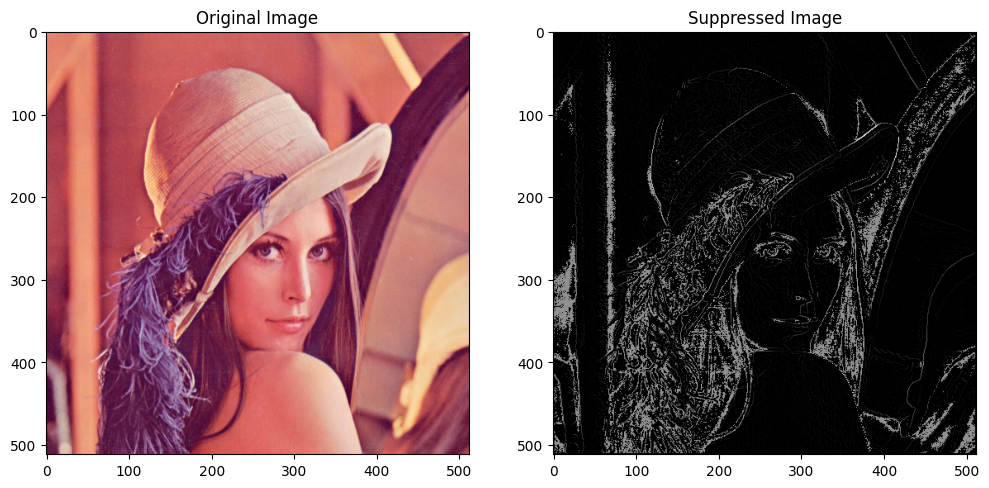

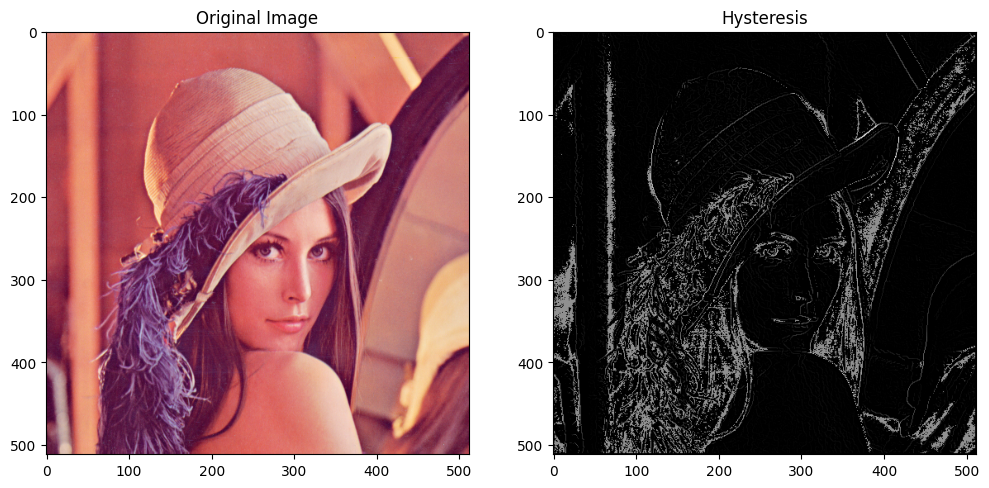

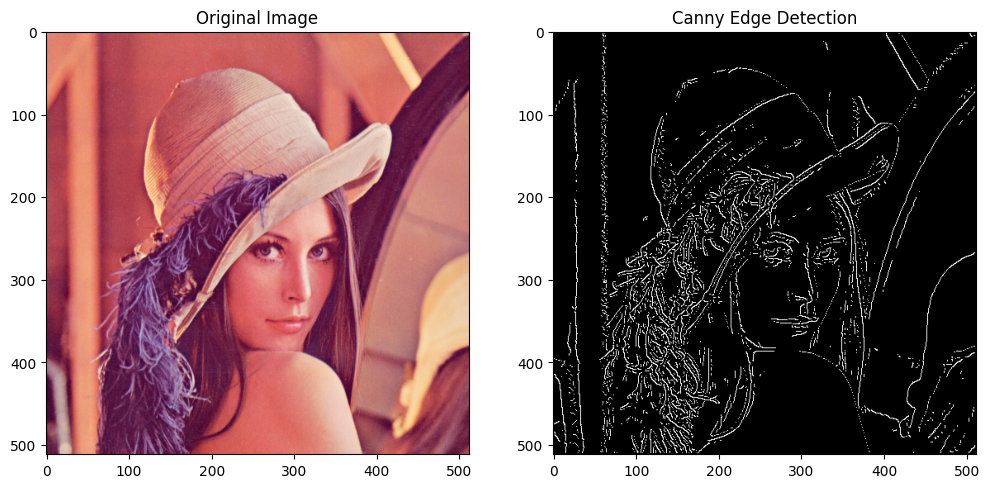

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def canny_edge_detection(image):

    # Step 1: Gray scale conversion
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Step 2: Noise reduction
    blurred_image = cv2.GaussianBlur(gray_image, (5, 5), 0)

    # Step 3: Gradient calculation
    gradient_x = cv2.Sobel(blurred_image, cv2.CV_64F, 1, 0, ksize=3)
    gradient_y = cv2.Sobel(blurred_image, cv2.CV_64F, 0, 1, ksize=3)
    gradient_magnitude = np.sqrt(gradient_x**2 + gradient_y**2)
    gradient_direction = np.arctan2(gradient_y, gradient_x)

    # Step 4: Non-maximum suppression
    suppressed_image = np.zeros_like(gradient_magnitude)
    for i in range(1, gradient_magnitude.shape[0] - 1):
        for j in range(1, gradient_magnitude.shape[1] - 1):
            angle = gradient_direction[i, j]
            if (0 <= angle < np.pi/4) or (7*np.pi/4 <= angle <= 2*np.pi):
                neighbors = [gradient_magnitude[i, j-1], gradient_magnitude[i, j+1]]
            elif (np.pi/4 <= angle < 3*np.pi/4):
                neighbors = [gradient_magnitude[i-1, j-1], gradient_magnitude[i+1, j+1]]
            elif (3*np.pi/4 <= angle < 5*np.pi/4):
                neighbors = [gradient_magnitude[i-1, j], gradient_magnitude[i+1, j]]
            else:
                neighbors = [gradient_magnitude[i-1, j+1], gradient_magnitude[i+1, j-1]]

            if gradient_magnitude[i, j] >= max(neighbors):
                suppressed_image[i, j] = gradient_magnitude[i, j]

    # Step 5: Double Thresholding and hysteresis
    high_threshold, low_threshold = 50, 30
    edges = np.zeros_like(suppressed_image)
    edges[(suppressed_image >= high_threshold) & (suppressed_image >= low_threshold)] = 255

    strong =  image >= high_threshold
    weak = (image < high_threshold) & (image >= low_threshold)

    # Step 6: hysteresis
    # print(image.shape)
    M, N = image.shape[:2]
    # print(M, N)
    img = suppressed_image

    # for i in range(1, M-1):
    #     for j in range(1, N-1):
    #         if weak[i, j]:
    #             if strong[i+1, j-1] or strong[i+1, j] or strong[i+1, j+1] or \
    #                strong[i, j-1] or strong[i, j+1] or strong[i-1, j-1] or \
    #                strong[i-1, j] or strong[i-1, j+1]:
    #                 image[i, j] = 255
    #             else:
    #                 image[i, j] = 0
    for i in range(1, M-1):
      for j in range(1, N-1):
        if np.any(weak[i, j]):
            if (np.any(strong[i+1, j-1]) or np.any(strong[i+1, j]) or np.any(strong[i+1, j+1]) or
                np.any(strong[i, j-1]) or np.any(strong[i, j+1]) or np.any(strong[i-1, j-1]) or
                np.any(strong[i-1, j]) or np.any(strong[i-1, j+1])):
                img[i, j] = 255
            else:
                img[i, j] = 0

    # for i in range(1, M-1):
    #   for j in range(1, N-1):
    #     if np.any(weak[i, j]):
    #         if (strong[i+1, j-1] != 0 or strong[i+1, j] != 0 or strong[i+1, j+1] != 0 or
    #             strong[i, j-1] != 0 or strong[i, j+1] != 0 or strong[i-1, j-1] != 0 or
    #             strong[i-1, j] != 0 or strong[i-1, j+1] != 0):
    #             img[i, j] = 255
    #         else:
    #             img[i, j] = 0


    # return gray_image, blurred_image, gradient_direction, suppressed_image, edges
    return gray_image, blurred_image, gradient_magnitude, gradient_direction, suppressed_image, img,edges

# Load Lena.png
lena_image = cv2.imread('Lena.png')

# Apply Canny Edge Detection
gray_image, blurred_image, gradient_magnitude, gradient_direction, suppressed_image, image,edges = canny_edge_detection(lena_image)



# Plot the results
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(gray_image, cmap='gray'), plt.title('Gray Image')
plt.show()

# Plot the results
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(blurred_image, cmap='gray'), plt.title('Noise Reduced Image')
plt.show()

# Plot the results
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(gradient_magnitude, cmap='gray'), plt.title('Gradient Magnitude')
plt.show()

# Plot the results
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(gradient_direction, cmap='gray'), plt.title('Gradient Direction Edges')
plt.show()

# Plot the results
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(suppressed_image, cmap='gray'), plt.title('Suppressed Image')
plt.show()

# Plot the results
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(image, cmap='gray'), plt.title('Hysteresis')
plt.show()

# Plot the results
plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(edges, cmap='gray'), plt.title('Canny Edge Detection')
plt.show()
# # Plot the results
# plt.figure(figsize=(12, 6))
# plt.subplot(121), plt.imshow(cv2.cvtColor(lena_image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
# plt.subplot(122), plt.imshow(edges, cmap='gray'), plt.title('Canny Edge Detection')
# plt.show()

**QUESTION 2**

In [ ]:
# # import cv2
# # import numpy as np
# # import matplotlib.pyplot as plt

# # def harris_keypoint_detector(image, k=0.04, threshold=10000):
# #     # Step 1: Calculate image gradients
# #     dx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
# #     dy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

# #     # Step 2: Calculate products of gradients
# #     Ixx = dx**2
# #     Iyy = dy**2
# #     Ixy = dx * dy

# #     # Step 3: Apply Gaussian smoothing
# #     Ixx = cv2.GaussianBlur(Ixx, (5, 5), 0)
# #     Iyy = cv2.GaussianBlur(Iyy, (5, 5), 0)
# #     Ixy = cv2.GaussianBlur(Ixy, (5, 5), 0)

# #     # Step 4: Calculate Harris corner response
# #     det = Ixx * Iyy - Ixy**2
# #     trace = Ixx + Iyy
# #     response = det - k * trace**2

# #     # Step 5: Non-maximum suppression
# #     corners = np.zeros_like(image)
# #     corners[response > threshold] = 255

# #     return corners

# # # Read the image
# # image = cv2.imread('Harris.png', cv2.IMREAD_GRAYSCALE)

# # # Apply your Harris keypoint detector
# # your_harris_corners = harris_keypoint_detector(image)

# # # Apply OpenCV's Harris keypoint detector
# # dst = cv2.cornerHarris(image, blockSize=2, ksize=3, k=0.04)

# # # Compare the results and visualize them
# # plt.subplot(131), plt.imshow(image, cmap='gray')
# # plt.title('Original Image'), plt.xticks([]), plt.yticks([])

# # plt.subplot(132), plt.imshow(your_harris_corners, cmap='gray')
# # plt.title('Your Harris Detector'), plt.xticks([]), plt.yticks([])

# # plt.subplot(133), plt.imshow(dst, cmap='gray')
# # plt.title('OpenCV Harris Detector'), plt.xticks([]), plt.yticks([])

# # plt.show()

# import cv2
# import numpy as np
# import matplotlib.pyplot as plt

# def harris_keypoint_detector(image, k=0.04, threshold=0.01):
#     # Step 1: Calculate image gradients
#     dx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
#     dy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

#     # Step 2: Calculate products of gradients
#     Ixx = dx**2
#     Iyy = dy**2
#     Ixy = dx * dy

#     # Step 3: Apply Gaussian smoothing
#     Ixx = cv2.GaussianBlur(Ixx, (5, 5), 0)
#     Iyy = cv2.GaussianBlur(Iyy, (5, 5), 0)
#     Ixy = cv2.GaussianBlur(Ixy, (5, 5), 0)

#     # Step 4: Calculate Harris corner response
#     det = Ixx * Iyy - Ixy**2
#     trace = Ixx + Iyy
#     response = det - k * trace**2

#     # Step 5: Non-maximum suppression
#     corners = np.zeros_like(image)
#     corners[response > threshold * response.max()] = 255

#     return corners

# # Read the image
# image = cv2.imread('Harris.png', cv2.IMREAD_GRAYSCALE)

# # Apply your Harris keypoint detector
# implemented_harris_corners = harris_keypoint_detector(image)

# # Apply OpenCV's Harris keypoint detector
# dst = cv2.cornerHarris(image, blockSize=2, ksize=3, k=0.04)

# # Dilate to mark the corners
# dst = cv2.dilate(dst, None)

# # Threshold the Harris response
# image[dst > 0.01 * dst.max()] = 255

# # Compare the results and visualize them
# plt.subplot(131), plt.imshow(image, cmap='gray')
# plt.title('Original Image'), plt.xticks([]), plt.yticks([])

# plt.subplot(132), plt.imshow(implemented_harris_corners, cmap='gray')
# plt.title('Implemented Harris Detector'), plt.xticks([]), plt.yticks([])

# plt.subplot(133), plt.imshow(dst, cmap='gray')
# plt.title('OpenCV Harris Detector'), plt.xticks([]), plt.yticks([])

# plt.show()

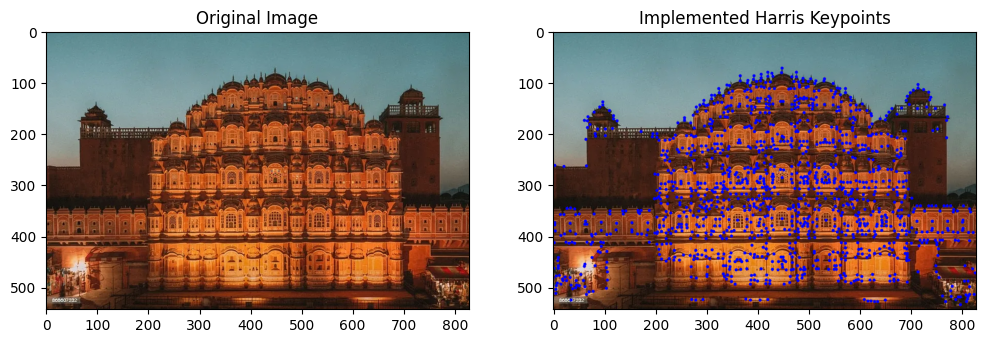

In [2]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt

# def harris_keypoint_detector(image, k=0.04, threshold=0.01):
#     # Step 1: Calculate image gradients
#     dx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
#     dy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

#     # Step 2: Calculate products of gradients
#     Ixx = dx**2
#     Iyy = dy**2
#     Ixy = dx * dy

#     # Step 3: Apply Gaussian smoothing
#     Ixx = cv2.GaussianBlur(Ixx, (5, 5), 0)
#     Iyy = cv2.GaussianBlur(Iyy, (5, 5), 0)
#     Ixy = cv2.GaussianBlur(Ixy, (5, 5), 0)

#     # Step 4: Calculate Harris corner response
#     det = Ixx * Iyy - Ixy**2
#     trace = Ixx + Iyy
#     response = det - k * trace**2

#     # Step 5: Non-maximum suppression
#     corners = np.zeros_like(image)
#     corners[response > threshold * response.max()] = 255

#     return corners



# # Apply Harris corner detector/ Implemented version
# implemented_harris_keypoints = harris_keypoint_detector(image)

# # Find centroids of the corners
# ret, labels, stats, centroids = cv2.connectedComponentsWithStats(implemented_harris_keypoints.astype(np.uint8))

# # Create an image with keypoints in blue for the custom implementation
# implemented_result = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
# for centroid in centroids[1:]:
#     x, y = int(centroid[0]), int(centroid[1])
#     cv2.circle(implemented_result, (x, y), 5, (255, 0, 0), -1)

# # Display the results using matplotlib
# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 2)
# plt.imshow(cv2.cvtColor(implemented_result, cv2.COLOR_BGR2RGB))
# plt.title('Implemented Harris Keypoints')

# plt.subplot(1, 2, 1)
# plt.imshow(image, cmap='gray')
# plt.title('Original Image')

# plt.show()


import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image in color
image = cv2.imread("Harris.png")

def harris_keypoint_detector(image, k=0.04, threshold=0.01):
    # Convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calculate image gradients
    dx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    dy = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)

    # Calculate products of gradients
    Ixx = dx**2
    Iyy = dy**2
    Ixy = dx * dy

    # Apply Gaussian smoothing
    Ixx = cv2.GaussianBlur(Ixx, (5, 5), 0)
    Iyy = cv2.GaussianBlur(Iyy, (5, 5), 0)
    Ixy = cv2.GaussianBlur(Ixy, (5, 5), 0)

    # Calculate Harris corner response
    det = Ixx * Iyy - Ixy**2
    trace = Ixx + Iyy
    response = det - k * trace**2

    # Non-maximum suppression
    corners = np.zeros_like(gray)
    corners[response > threshold * response.max()] = 255

    return corners

# Harris corner detector/ Implemented version
implemented_harris_keypoints = harris_keypoint_detector(image)

# Find centroids of the corners
ret, labels, stats, centroids = cv2.connectedComponentsWithStats(implemented_harris_keypoints.astype(np.uint8))

# Create an image with keypoints in blue for the custom implementation
implemented_result = image.copy()
for centroid in centroids[1:]:
    x, y = int(centroid[0]), int(centroid[1])
    cv2.circle(implemented_result, (x, y), 3, (255, 0, 0), -1)

# Display the results using matplotlib
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(implemented_result, cv2.COLOR_BGR2RGB))
plt.title('Implemented Harris Keypoints')

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.show()

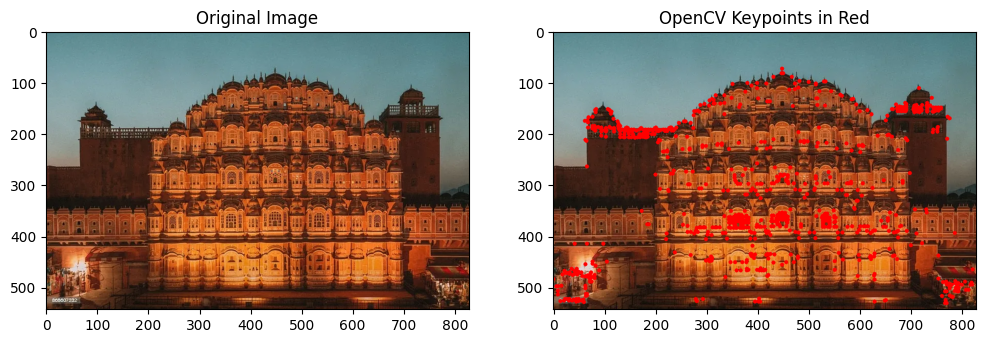

In [10]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt

# # # Load the image
# # image = cv2.imread("Harris.png", cv2.IMREAD_GRAYSCALE)

# # Apply Harris corner detector using OpenCV
# dst = cv2.cornerHarris(image, blockSize=2, ksize=3, k=0.04)

# # Normalize and threshold the result
# dst = cv2.normalize(dst, None, 0, 255, cv2.NORM_MINMAX)
# _, harris_corners = cv2.threshold(dst, 0.1 * dst.max(), 255, cv2.THRESH_BINARY)

# # Find centroids of the corners
# ret, labels, stats, centroids = cv2.connectedComponentsWithStats(harris_corners.astype(np.uint8))

# # Create an image with keypoints in red
# result_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
# for centroid in centroids[1:]:
#     x, y = int(centroid[0]), int(centroid[1])
#     cv2.circle(result_image, (x, y), 5, (0, 0, 255), -1)

# # Display the results using matplotlib
# plt.figure(figsize=(12, 6))

# plt.subplot(1, 2, 1)
# plt.imshow(image, cmap='gray')
# plt.title('Original Image')

# # plt.subplot(1, 3, 2)
# # plt.imshow(harris_corners, cmap='gray')
# # plt.title('OpenCV Harris Corners')

# plt.subplot(1, 2, 2)
# plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
# plt.title('OpenCV Keypoints in Red')

# plt.show()

import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image in color
image = cv2.imread("Harris.png")

# Harris corner detector using OpenCV
dst = cv2.cornerHarris(cv2.cvtColor(image, cv2.COLOR_BGR2GRAY), blockSize=2, ksize=3, k=0.04)

# Normalize and threshold the result
dst = cv2.normalize(dst, None, 0, 255, cv2.NORM_MINMAX)
_, harris_corners = cv2.threshold(dst, 0.1 * dst.max(), 255, cv2.THRESH_BINARY)

# Find centroids of the corners
ret, labels, stats, centroids = cv2.connectedComponentsWithStats(harris_corners.astype(np.uint8))

# Create an image with keypoints in red
result_image = image.copy()
for centroid in centroids[1:]:
    x, y = int(centroid[0]), int(centroid[1])
    cv2.circle(result_image, (x, y), 4, (0, 0, 255), -1)

# Display the results using matplotlib
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

# plt.subplot(1, 3, 2)
# plt.imshow(harris_corners, cmap='gray')
# plt.title('OpenCV Harris Corners')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.title('OpenCV Keypoints in Red')

plt.show()

In [ ]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt

# def harris_keypoint_detector(image, k=0.04, threshold=0.01):
#     # Step 1: Calculate image gradients
#     dx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
#     dy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

#     # Step 2: Calculate products of gradients
#     Ixx = dx**2
#     Iyy = dy**2
#     Ixy = dx * dy

#     # Step 3: Apply Gaussian smoothing
#     Ixx = cv2.GaussianBlur(Ixx, (5, 5), 0)
#     Iyy = cv2.GaussianBlur(Iyy, (5, 5), 0)
#     Ixy = cv2.GaussianBlur(Ixy, (5, 5), 0)

#     # Step 4: Calculate Harris corner response
#     det = Ixx * Iyy - Ixy**2
#     trace = Ixx + Iyy
#     response = det - k * trace**2

#     # Step 5: Non-maximum suppression
#     corners = np.zeros_like(image)
#     corners[response > threshold * response.max()] = 255

#     return corners

# # Load the image
# image = cv2.imread("Harris.png", cv2.IMREAD_GRAYSCALE)

# # Apply Harris corner detector using the implemented function
# custom_harris_corners = harris_keypoint_detector(image)

# # Apply Harris corner detector using OpenCV
# dst = cv2.cornerHarris(image, blockSize=2, ksize=3, k=0.04)

# # Normalize and threshold the result
# dst = cv2.normalize(dst, None, 0, 255, cv2.NORM_MINMAX)
# _, opencv_harris_corners = cv2.threshold(dst, 0.1 * dst.max(), 255, cv2.THRESH_BINARY)

# # Combine keypoints from both detectors
# result_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
# result_image[custom_harris_corners == 255] = [255, 0, 0]  # Blue
# result_image[opencv_harris_corners == 255] = [0, 0, 255]  # Red
# result_image[(custom_harris_corners == 255) & (opencv_harris_corners == 255)] = [128, 0, 128]  # Purple

# # Display the result using matplotlib
# plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
# plt.title('Implemented Harris (Blue), OpenCV Harris (Red), Coincident (Purple) Keypoints')
# plt.show()

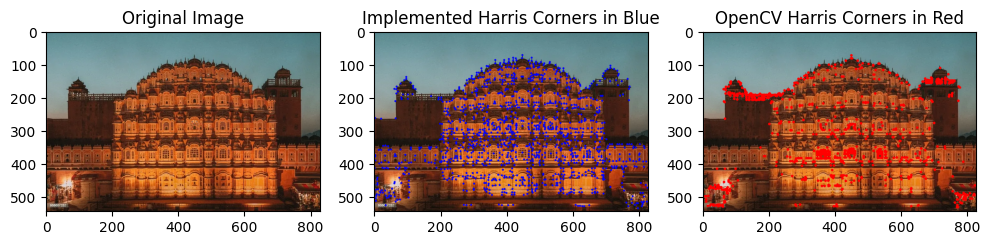

In [11]:
# plt.figure(figsize=(12, 6))

# plt.subplot(1, 3, 1)
# plt.imshow(image, cmap='gray')
# plt.title('Original Image')

# plt.subplot(1, 3, 2)
# plt.imshow(cv2.cvtColor(custom_result_image, cv2.COLOR_BGR2RGB))
# plt.title('Implemented Harris Corners in Blue')

# plt.subplot(1, 3, 3)
# plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
# plt.title('opencv Harris Corners in Red')

# plt.show()

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(implemented_result, cv2.COLOR_BGR2RGB))
plt.title('Implemented Harris Corners in Blue')

plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.title('OpenCV Harris Corners in Red')

plt.show()

In [ ]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt
# from scipy.ndimage import convolve

# def harris_keypoint_detector(image, k=0.04, threshold=0.01):
#     # Step 1: Calculate image gradients
#     dx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
#     dy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

#     # Step 2: Calculate products of gradients
#     Ixx = dx**2
#     Iyy = dy**2
#     Ixy = dx * dy

#     # Step 3: Apply Gaussian smoothing
#     Ixx = cv2.GaussianBlur(Ixx, (5, 5), 0)
#     Iyy = cv2.GaussianBlur(Iyy, (5, 5), 0)
#     Ixy = cv2.GaussianBlur(Ixy, (5, 5), 0)

#     # Step 4: Calculate Harris corner response
#     det = Ixx * Iyy - Ixy**2
#     trace = Ixx + Iyy
#     response = det - k * trace**2

#     # Step 5: Non-maximum suppression
#     corners = np.zeros_like(image)
#     corners[response > threshold * response.max()] = 255

#     return corners

# # Load the image
# image = cv2.imread("Harris.png", cv2.IMREAD_GRAYSCALE)

# # Apply Harris corner detector using the implemented function
# custom_harris_corners = harris_keypoint_detector(image)

# # Find centroids of the corners for the implemented detector
# ret, labels, stats, centroids_custom = cv2.connectedComponentsWithStats(custom_harris_corners.astype(np.uint8))

# # Apply Harris corner detector using OpenCV
# dst = cv2.cornerHarris(image, blockSize=2, ksize=3, k=0.04)

# # Normalize and threshold the result
# dst = cv2.normalize(dst, None, 0, 255, cv2.NORM_MINMAX)
# _, opencv_harris_corners = cv2.threshold(dst, 0.1 * dst.max(), 255, cv2.THRESH_BINARY)

# # Find centroids of the corners for OpenCV detector
# ret, labels, stats, centroids_opencv = cv2.connectedComponentsWithStats(opencv_harris_corners.astype(np.uint8))

# # Create an image with keypoints in blue for the implemented detector
# result_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
# for centroid in centroids_custom[1:]:
#     x, y = int(centroid[0]), int(centroid[1])
#     cv2.circle(result_image, (x, y), 5, (255, 0, 0), -1)

# # Create an image with keypoints in red for OpenCV detector
# for centroid in centroids_opencv[1:]:
#     x, y = int(centroid[0]), int(centroid[1])
#     cv2.circle(result_image, (x, y), 5, (0, 0, 255), -1)
# # for centroid in centroids_opencv[1:]:
# #     x, y = int(centroid[0]), int(centroid[1])
# #     if result_image[x, y][0] == 255:  # If already blue, make it green
# #         result_image[x, y] = [0, 255, 0]  # Green
# #     else:
# #         result_image[x, y] = [0, 0, 255]  # Red

# # Display the result using matplotlib
# plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
# plt.title('Implemented Harris (Blue) and OpenCV Harris (Red) Keypoints')
# plt.show()

**QUESTION 3**

In [36]:
# import cv2
# import matplotlib.pyplot as plt

# # Load the image
# img = cv2.imread('img3.jpg')

# # Convert to grayscale (if necessary)
# gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# # Create MSER object
# mser = cv2.MSER_create()

# # Initialize hyperparameters
# delta = 5
# min_area = 100
# max_area = 10000
# max_variation = 0.25
# min_diversity = 0.2

# # Iterate and refine hyperparameters
# while True:
#     # Detect regions with current hyperparameters
#     regions, _ = mser.detectRegions(gray)

#     # Filter for smallest blobs
#     desired_area = 100  # Adjust this value as needed
#     smallest_blobs = [region for region in regions if cv2.contourArea(region) < desired_area]

#     # Draw red squares around blobs
#     for region in smallest_blobs:
#         x, y, w, h = cv2.boundingRect(region)
#         cv2.rectangle(img, (x, y), (x+w, y+h), (0, 0, 255), 2)

#     # Display results
#     plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
#     plt.show()

#     # Refine hyperparameters based on visual inspection
#     # (Adjust delta, min_area, max_area, max_variation, min_diversity)
#     # ...

#     # Check if satisfied with results
#     satisfied = input("Are you satisfied with the detection? (y/n): ")
#     if satisfied.lower() == 'y':
#         break

# # Save results (optional)
# cv2.imwrite('img3_output.jpg', img)

# # Report final hyperparameters
# print("Final hyperparameters:")
# print("delta:", delta)
# print("min_area:", min_area)
# print("max_area:", max_area)
# print("max_variation:", max_variation)
# print("min_diversity:", min_diversity)

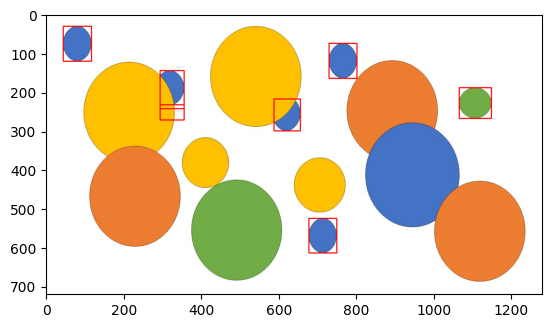

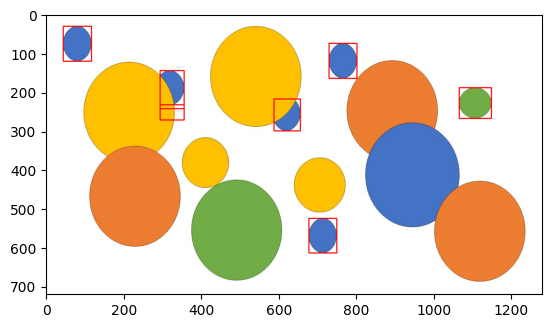

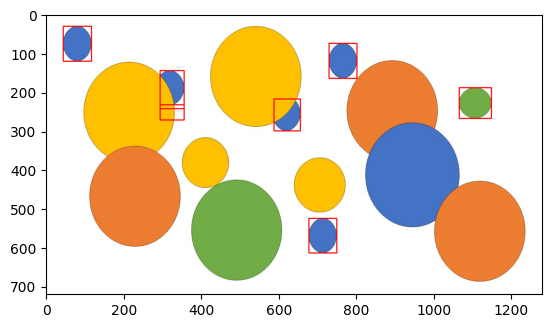

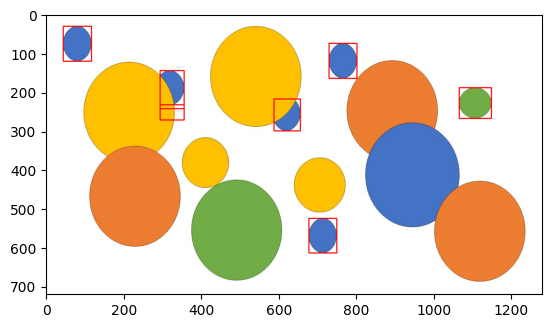

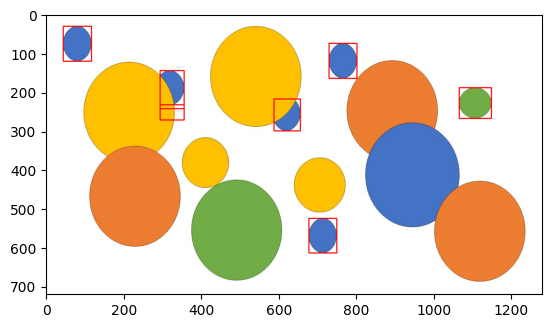

...

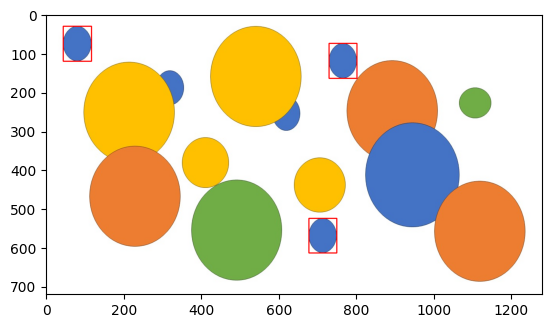

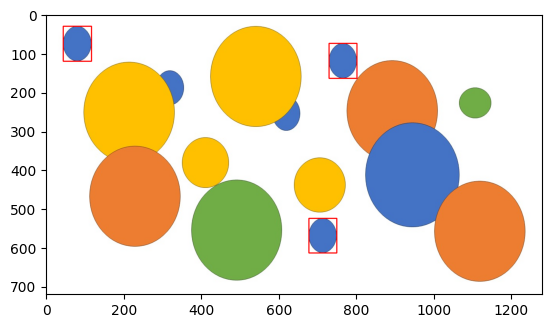

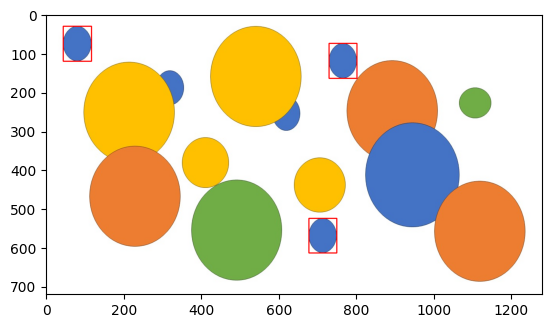

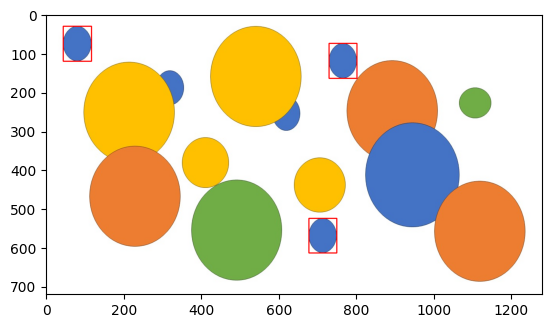

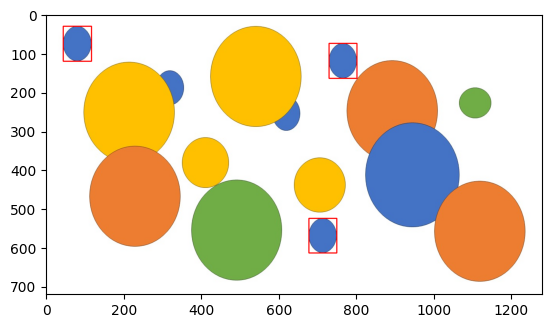

In [13]:
import cv2
import matplotlib.pyplot as plt

def MSER(image_path, i=110, j=500, k=2500, l=9600):


    mser_params = {'delta': i, 'max_variation': j, 'min_area': k, 'max_area': l}
    mser = cv2.MSER_create(**mser_params)

    color_image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(color_image, cv2.COLOR_BGR2GRAY)

    regions, _ = mser.detectRegions(gray_image)

    for region in regions:
        x, y, w, h = cv2.boundingRect(region)
        cv2.rectangle(color_image, (x, y), (x + w, y + h), (0, 0, 255), 2)

    rgb_image = cv2.cvtColor(color_image, cv2.COLOR_BGR2RGB)
    plt.imshow(rgb_image)
    plt.show()

def run_to_all(path,amongst):
    delta_am = amongst[0]
    max_variation_am = amongst[1]
    min_area_am = amongst[2]
    max_area_am = amongst[3]
    for i in delta_am:
      for j in max_variation_am:
        for k in min_area_am:
          for l in max_area_am:
            MSER(path,i,j,k,l)
amongst = []
delta_am = [100,110,120]
max_variation_am = [400,450,500,550]
min_area_am = [2000,2500,3000,3500]
max_area_am = [9000,9300,9600,9900]
amongst.append(delta_am)
amongst.append(max_variation_am)
amongst.append(min_area_am)
amongst.append(max_area_am)

run_to_all('img3.jpg',amongst)


From hyperparameters in:</br>
delta_am = [100,110,120]</br>
max_variation_am = [400,450,500,550]</br>
min_area_am = [2000,2500,3000,3500]</br>
max_area_am = [9000,9300,9600,9900]</br>
The following combination works well so i give the hyperparams below to MSER by default:</br>
delta_am = 110</br>
max_variation_am = 500</br>
min_area_am = 2500</br>
max_area_am = 9600</br>

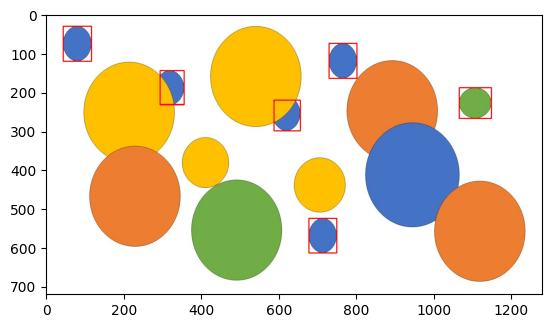

In [14]:
# Final hyperparameters
MSER('img3.jpg')

**QUESTION 4**

In [44]:
# import cv2
# import numpy as np
# from matplotlib import pyplot as plt

# def sift_matching(template_path, target_path):
#     # Load images
#     img1 = cv2.imread(template_path, cv2.IMREAD_GRAYSCALE)
#     img2 = cv2.imread(target_path, cv2.IMREAD_GRAYSCALE)

#     # Initialize SIFT detector
#     sift = cv2.SIFT_create()

#     # Find the keypoints and descriptors with SIFT
#     kp1, des1 = sift.detectAndCompute(img1, None)
#     kp2, des2 = sift.detectAndCompute(img2, None)

#     # FLANN parameters
#     FLANN_INDEX_KDTREE = 1
#     index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
#     search_params = dict(checks=50)

#     # FLANN-based matcher
#     flann = cv2.FlannBasedMatcher(index_params, search_params)

#     # Match descriptors
#     matches = flann.knnMatch(des1, des2, k=2)

#     # Need to draw only good matches, so create a mask
#     matchesMask = [[0, 0] for _ in range(len(matches))]

#     # Ratio test as per Lowe's paper
#     for i, (m, n) in enumerate(matches):
#         if m.distance < 0.7 * n.distance:
#             matchesMask[i] = [1, 0]

#     # Draw matches
#     img_matches = cv2.drawMatchesKnn(img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

#     # Display the result using matplotlib
#     plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
#     plt.title('SIFT Matches')
#     plt.show()

# # Call the function with the template and target image paths
# sift_matching('template.jpg', 'img4.jpg')

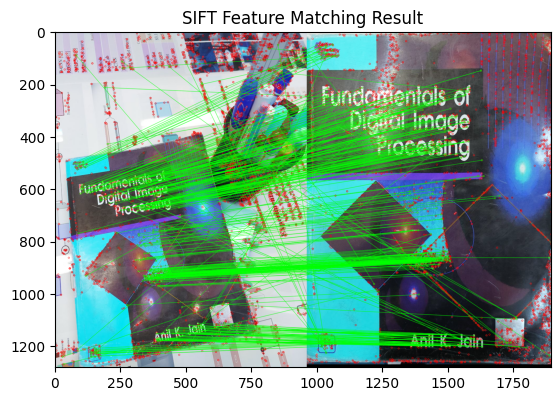

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load images
img1 = cv2.imread('img4.jpg')
img2 = cv2.imread('template.jpg')

# Convert images to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Initialize SIFT detector
sift = cv2.SIFT_create()

# Find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(gray1, None)
kp2, des2 = sift.detectAndCompute(gray2, None)

# FLANN parameters
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)

# FLANN matcher
flann = cv2.FlannBasedMatcher(index_params, search_params)
matches = flann.knnMatch(des1, des2, k=2)

# Need to draw only good matches, so create a mask
matchesMask = [[0, 0] for _ in range(len(matches))]

# Ratio test as per Lowe's paper
for i, (m, n) in enumerate(matches):
    if m.distance < 0.7 * n.distance:
        matchesMask[i] = [1, 0]

draw_params = dict(matchColor=(0, 255, 0),
                   singlePointColor=(255, 0, 0),
                   matchesMask=matchesMask,
                   flags=0)

# Draw matches
img_matches = cv2.drawMatchesKnn(img1, kp1, img2, kp2, matches, None, **draw_params)

# Display the result using matplotlib
plt.imshow(img_matches)
plt.title('SIFT Feature Matching Result')
plt.show()